In [1]:
%matplotlib inline
from __future__ import division, absolute_import
from __future__ import print_function, unicode_literals

import glob

import numpy as np

import obspy
from obspy.geodetics import calc_vincenty_inverse

from IPython.display import HTML

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.collections import PatchCollection
from matplotlib import animation, rc
from mpl_toolkits.mplot3d import Axes3D
import mpl_toolkits.mplot3d.art3d as art3d

import cartopy.crs as ccrs
import cartopy.feature as cfeature

from tqdm import tqdm_notebook as tqdm
import re

import datetime

import pandas as pd
import seaborn as sns
sns.set_style("white")
sns.set_context("talk")

rc('animation', html='jshtml')

/home/orsvuran/.virtualenvs/py2/lib/python2.7/site-packages/obspy/core/util/base.py:383: UserWarning: 'Proj.proj_version' is deprecated. Please use `pyproj.proj_version_str` instead.
  version_string = str(Proj(proj='utm', zone=10, ellps='WGS84').proj_version)


In [2]:
def plot_map():
    """Harita icin figür hazırlayıp geri döndürür."""
    fig, ax = plt.subplots(figsize=(18, 10), subplot_kw={'projection': ccrs.PlateCarree()})
    ax.set_extent([25, 45, 34,43], crs=ccrs.PlateCarree())
    borders = cfeature.NaturalEarthFeature('cultural', 'admin_0_boundary_lines_land', '50m',
                                           edgecolor="black", facecolor="none")
    coastline = cfeature.NaturalEarthFeature('physical', 'coastline', '50m',
                                             edgecolor="black", facecolor="none")
    land = cfeature.NaturalEarthFeature('physical', 'land', '10m',
                                        edgecolor="black", facecolor="#eeeeee")
    ocean = cfeature.NaturalEarthFeature('physical', 'ocean', '10m',
                                        edgecolor="none", facecolor="#aeddee")
    ax.add_feature(borders, zorder=3)
    ax.add_feature(land, zorder=2)
    ax.add_feature(ocean, zorder=1)
    return fig, ax


In [3]:
def get_point_from(lat, lon, dist, az):
    # http://www.movable-type.co.uk/scripts/latlong.html
    rlat = np.radians(lat)
    rlon = np.radians(lon)
    R = 6371.0
    d = dist/R
    lat2 = np.arcsin(np.sin(rlat)*np.cos(d) + np.cos(rlat)*np.sin(d)*np.cos(az))
    lon2 = rlon + np.arctan2(np.sin(az)*np.sin(d)*np.cos(rlat),
                             np.cos(d)-np.sin(rlat)*np.sin(lat2))
    return np.degrees(lat2), np.degrees(lon2)

def get_dist_circle(lat, lon, dist):
    circle = np.linspace(0, 2*np.pi-0.001, 1000)
    cx = []
    cy = []
    for caz in circle:
        a, b = get_point_from(lat, lon, dist, caz)
        cx.append(a)
        cy.append(b)
    return cx, cy


def notebook_anim(fig, anim_func, *args, **kwargs):
    anim = animation.FuncAnimation(fig, anim_func, *args, **kwargs)
    return anim

def write_anim_avi(anim, fps, filename):
    Writer = animation.writers['ffmpeg']
    writer = Writer(fps=fps, metadata=dict(artist='DerJeofizik'), bitrate=1800)
    anim.save(filename, writer=writer)

SEJveChjaGlsZHJlbj0oSW50UHJvZ3Jlc3ModmFsdWU9MCwgZGVzY3JpcHRpb249dSdBbmltYXRpb24nLCBtYXg9MzAsIHN0eWxlPVByb2dyZXNzU3R5bGUoZGVzY3JpcHRpb25fd2lkdGg9dSfigKY=


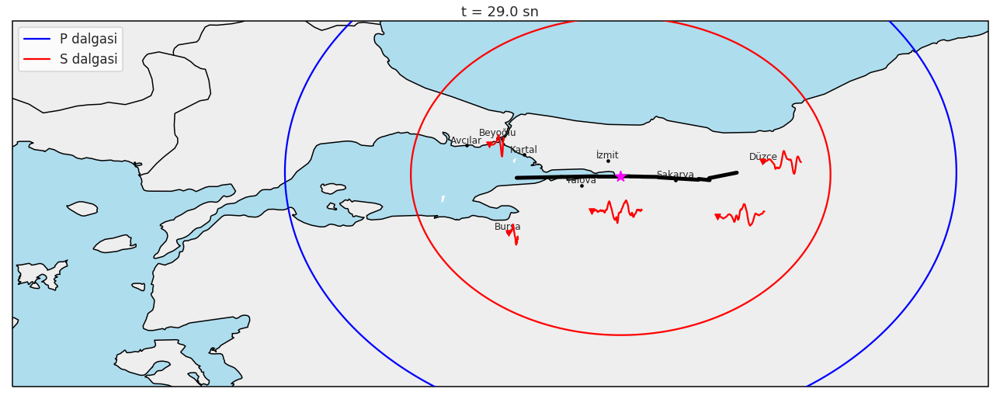

In [4]:
# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plot_map()
# lat = 40.70
# lon = 29.91
evlo = 29.9870
evla = 40.7250

vp = 8.0
vs = 5.0

ax.set_extent([25, 33, 39, 42])
ax.scatter(evlo, evla, 200, marker="*", color="magenta", zorder=10)
cx, cy = get_dist_circle(evla, evlo, 0)
pline, = ax.plot(
    cy, cx, color="b", transform=ccrs.Geodetic(), label="P dalgasi", zorder=10
)
sline, = ax.plot(
    cy, cx, color="r", transform=ccrs.Geodetic(), label="S dalgasi", zorder=10
)
ax.legend()
fig.tight_layout()

lons = [29.88152, 29.66667, 29.063448, 30.435763, 31.15654, 28.7214, 28.9774, 29.1936]
lats = [40.85327, 40.65000, 40.266864, 40.693997, 40.843849, 40.9792, 41.0371, 40.8999]
labels = [
    "İzmit",
    "Yalova",
    "Bursa",
    "Sakarya",
    "Düzce",
    "Avcılar",
    "Beyoğlu",
    "Kartal",
]
ax.scatter(lons, lats, 10, marker="o", color="k", zorder=10, transform=ccrs.Geodetic())
for label, lat, lon in zip(labels, lats, lons):
    ax.text(
        lon,
        lat,
        label,
        fontsize=12,
        verticalalignment="bottom",
        horizontalalignment="center",
        transform=ccrs.Geodetic(),
    )

fault_lons = [
    [29.7988790011, 29.1341205836],
    [29.9870612165, 29.7999398884],
    [30.0591859904, 29.9908148179],
    [30.1560545297, 30.0639452741],
    [30.2972999383, 30.1576988962],
    [30.6258009245, 30.2971986374],
    [30.7166135242, 30.6253867752],
    [30.9395737106, 30.7124265734],
]

fault_lats = [
    [40.7240960633, 40.7109039367],
    [40.725, 40.725],
    [40.7237643992, 40.7242356008],
    [40.7213717573, 40.7226282427],
    [40.7185576392, 40.7204423608],
    [40.6951149165, 40.7148850835],
    [40.6919897591, 40.702009521],
    [40.7535324879, 40.7084675121],
]
for lons, lats in zip(fault_lons, fault_lats):
    ax.plot(lons, lats, "-k", lw=5, zorder=8, transform=ccrs.Geodetic())

size_t = 100
size_amp = 0.1

stations = []
for filename in glob.glob("./seismic_data/*.HGZ.SAC"):
    tr = obspy.read(filename, format="SAC")[0]

    for _ in range(2):
        tr.detrend("demean")
        tr.detrend("linear")
        tr.taper(0.05)
        tr.integrate()

    tr_len = len(tr.data)
    tr_plot, = ax.plot([], [], "r", zorder=100, transform=ccrs.Geodetic())
    dist_m, _, _ = calc_vincenty_inverse(
        evla, evlo, tr.stats.sac.stla, tr.stats.sac.stlo
    )
    p_arrival = dist_m / 1000 / vp

    stations.append(
        {
            "name": tr.id,
            "lat": tr.stats.sac.stla,
            "lon": tr.stats.sac.stlo,
            "trace": tr,
            "length": tr_len,
            "plot": tr_plot,
            "amp_scale": size_amp / np.abs(tr.data).max(),
            "time_scale": size_t / tr_len,
            "t_offset": p_arrival - tr.stats.sac.a,
        }
    )


ax.scatter(
    [s["lon"] for s in stations],
    [s["lat"] for s in stations],
    50,
    marker="v",
    color="r",
    zorder=20,
)


def init():
    pline.set_data([], [])
    sline.set_data([], [])
    for s in stations:
        s["plot"].set_data([], [])
    return (pline,)


fps = 1
frames = 30 * fps

pbar = None


def animate(i):
    global pbar
    t = i / fps*1
    if i == 0:
        pbar = tqdm(total=frames, desc="Animation")

    cx, cy = get_dist_circle(evla, evlo, vp * t)
    pline.set_data(cy, cx)

    cx, cy = get_dist_circle(evla, evlo, vs * t)
    sline.set_data(cy, cx)
    ax.set_title("t = {:.1f} sn".format(t))
    for sta in stations:
        tr = sta["trace"]
        tend = t - sta["t_offset"]
        if tend > 0:
            n = int(tend // tr.stats.delta)
            sta["plot"].set_data(
                [
                    sta["lon"] + (tr.times()[:n]) * sta["time_scale"],
                    sta["lat"] + tr.data[:n] * sta["amp_scale"],
                ]
            )

    pbar.update()
    return pline, sline


anim = notebook_anim(
    fig,
    animate,
    init_func=init,
    frames=frames,
    interval=1000.0 / fps,
    blit=True,
    save_count=frames,
)

# write_anim_avi(anim, fps, "wave_propagation.avi")
anim

In [5]:
def ramp_value(rise_time, rupture_time, t):
    if t < rupture_time:
        return 0
    elif t > rupture_time + rise_time:
        return 1
    else:
        rt = t - rupture_time
        return 1.0/rise_time*rt

SEJveChjaGlsZHJlbj0oSW50UHJvZ3Jlc3ModmFsdWU9MCwgZGVzY3JpcHRpb249dSdBbmltYXRpb24nLCBtYXg9MzAsIHN0eWxlPVByb2dyZXNzU3R5bGUoZGVzY3JpcHRpb25fd2lkdGg9dSfigKY=


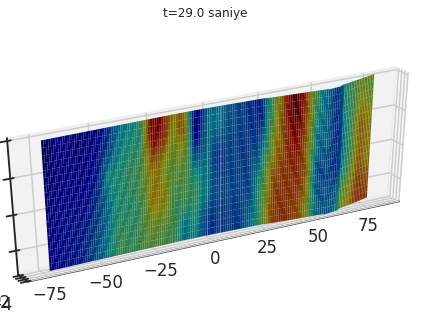

In [6]:
data_started = False

xs = []
ys = []
zs = []
slips = []

was_here = False
pp = None
offsetX = 0
offsetY = 0
read_top_center_next = False
read_len_wid_next = False
source_lat = 0.0
source_lon = 0.0
source_depth = 0.0
center_lat = 0.0
center_lon = 0.0
segment_width = 0
segment_length = 0
rises = []
trups = []


loc = re.compile(
    r"""^% Loc\s+:\s+LAT\s+=\s+(?P<lat>[\.\d]+)\s+LON\s+=\s+(?P<lon>[\.\d]+)\s+DEP\s+=\s+(?P<depth>[\.\d]+)"""
)
segment = re.compile(
    ".*STRIKE\s+=\s+(?P<strike>[\.\d]+)\s+deg\s+DIP\s+=\s+(?P<dip>[\.\d]+)\s+deg.*"
)
segment2 = re.compile(
    ".*LEN\s+=\s+(?P<len>[\.\d]+)\s+km\s+WID\s+=\s+(?P<wid>[\.\d]+)\s+km.*"
)

fig, ax = plt.subplots(figsize=(7, 5), subplot_kw={"projection": "3d"})

patches = []

with open("s1999IZMITT01BOUC.fsp") as f:
    for line in tqdm(f):
        if line.startswith("%"):
            if line.startswith("% Loc"):
                m = loc.match(line)
                if m:
                    vals = m.groupdict()
                    source_lat = float(vals["lat"])
                    source_lon = float(vals["lon"])
                    source_depth = float(vals["depth"])
                else:
                    raise Exception("Couldn't read Location line")
            elif read_top_center_next:
                center_lat, center_lon = [
                    float(x.split("=")[1]) for x in line.split(",")
                ]
                read_top_center_next = False
                dist_m, az, baz = calc_vincenty_inverse(
                    source_lat, source_lon, center_lat, center_lon
                )
                dist_km = dist_m / 1000.0
                offsetX = dist_km * np.sin(np.deg2rad(az))
                offsetY = dist_km * np.cos(np.deg2rad(az))
                proj_dist_km = np.dot(np.array((offsetX, offsetY, 0)), strike_v)
            elif "coordinates of top-center:" in line:
                read_top_center_next = True
            elif "SEGMENT # " in line:
                read_len_wid_next = True
                m = segment.match(line)
                if m:
                    vals = m.groupdict()
                    strike_r = np.deg2rad(float(vals["strike"]))
                    dip_r = np.deg2rad(float(vals["dip"]))
                    strike_v = np.array((np.sin(strike_r), np.cos(strike_r), 0))
                    strike_v /= np.linalg.norm(strike_v)
                    dip_v = np.array((0, 0, np.sin(dip_r)))
                    dip_v /= np.linalg.norm(dip_v)
                else:
                    raise Exception("Couldn't read segment line: \n {}".format(line))
            elif read_len_wid_next:
                read_len_wid_next = False
                m = segment2.match(line)
                if m:
                    vals = m.groupdict()
                    segment_length = float(vals["len"])
                    segment_width = float(vals["wid"])
                else:
                    raise Exception("Couldn't read second segment line.")
        else:
            data_started = True
            lat, lon, x, y, z, slip, rise, trup = [float(x) for x in line.split()]
            xs.append(x)
            ys.append(y)
            zs.append(z)
            v = np.array((x, y, z))
            strike_end = v + strike_v
            dip_end = v+dip_v
            far_end = v+strike_v+dip_v
            patches.append((np.array([[x, strike_end[0]], [dip_end[0], far_end[0]]]),
                            np.array([[y, strike_end[1]], [dip_end[1], far_end[1]]]),
                            np.array([[z, strike_end[2]], [dip_end[2], far_end[2]]])))
            trups.append(trup)
            rises.append(rise)
            slips.append(slip)


slips = np.array(slips)
ax.get_proj = lambda: np.dot(Axes3D.get_proj(ax), np.diag([2.0, 0.1, 1.0, 1]))

ax.view_init(30, -120)
ax.set_zlim([18, 0])

# animation function. This is called sequentially
fps = 1
frames = 30 * fps

max_slip = np.max(slips)

def init():
    for patch in patches:
        x, y, z = patch
        plots.append(ax.plot_surface(x, y, z, color=cmap(0), edgecolor="none"))
    return plots

def animate(i):
    global pbar
    t = i / fps
    if i == 0:
        pbar = tqdm(total=frames, desc="Animation")
    t = i / fps
    # Overwriting previous one was causing problems, so I replot the whole thing.
    global plots
    for p in plots:
        p.remove()
    cur_slips = np.array(
        [
            ramp_value(rise, trup, t) * slip
            for trup, rise, slip in zip(trups, rises, slips)
        ]
    )
    plots = []
    for patch, slip in zip(patches, cur_slips):
        x, y, z = patch
        plots.append(ax.plot_surface(x, y, z, color=cmap(slip/max_slip), edgecolor="none"))
    fig.suptitle("t={:.1f} saniye".format(t))
    pbar.update()
    return plots


norm = plt.Normalize(0, 7)
colors = plt.cm.jet(norm(slips))
cmap = plt.cm.get_cmap("jet")
plots = []




anim = notebook_anim(
    fig, animate, init_func=init, frames=frames, interval=1000.0 / fps, blit=True, save_count=frames
)

# write_anim_avi(anim, fps, "bouc_fault_plane.avi")

anim

SEJveChjaGlsZHJlbj0oSW50UHJvZ3Jlc3ModmFsdWU9MCwgZGVzY3JpcHRpb249dSdBbmltYXRpb24nLCBtYXg9MTM4LCBzdHlsZT1Qcm9ncmVzc1N0eWxlKGRlc2NyaXB0aW9uX3dpZHRoPXXigKY=


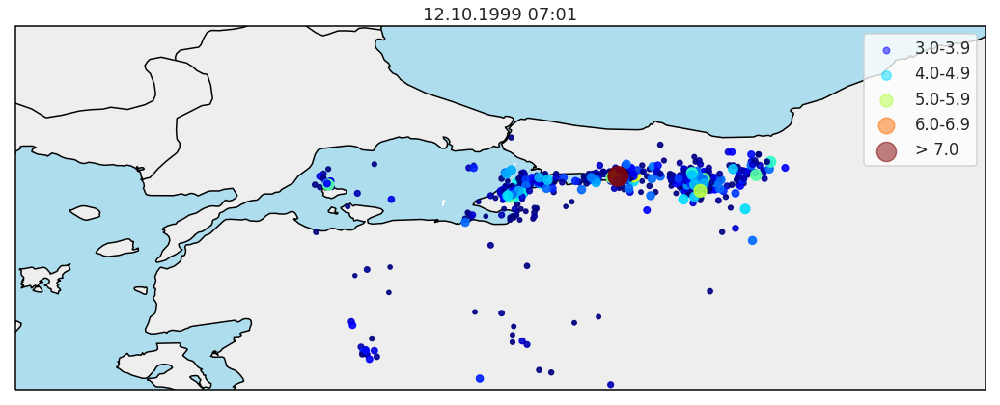

In [7]:
events = []
lats = []
lons = []
mags = []
dates = []
with open("./depremler.txt") as f:
    f.readline()  # Header
    for line in f:
        data = line.split()
        lats.append(float(data[4]))
        lons.append(float(data[5]))
        mags.append(float(data[7]))
        dates.append(
            datetime.datetime.strptime(" ".join(data[2:4])[:-3], "%Y.%m.%d %H:%M:%S")
        )
        events.append(
            {
                "date": datetime.datetime.strptime(
                    " ".join(data[2:4])[:-3], "%Y.%m.%d %H:%M:%S"
                ),
                "lat": float(data[4]),
                "lon": float(data[5]),
                "mag": float(data[7]),
            }
        )


mags = np.array(mags)
start = min(dates)
stop = max(dates)
length = max(dates) - min(dates)

df = pd.DataFrame(events)


steps = np.logspace(-2, 0, frames)
inv_steps = 1.0 // steps

pbar = None
sc = None


def increments(start, end, x_after_a_day=2):
    curr_inc = datetime.timedelta(hours=1)
    cum_inc = datetime.timedelta(0)
    curr = start + cum_inc
    i = 1
    while True:
        if i % 24 == 0:
            curr_inc = curr_inc * x_after_a_day
        cum_inc = cum_inc + curr_inc
        curr = start + cum_inc
        if curr > end:
            raise StopIteration()
        else:
            yield cum_inc
        i += 1


incs = list(increments(start, stop))
frames = len(incs)
fps = 10


def init():
    global sc
    sc = ax.scatter(
        df["lon"],
        df["lat"],
        c=df["mag"],
        s=df["mag"] ** 3,
        vmin=3,
        vmax=7.4,
        alpha=0.8,
        cmap="jet",
        transform=ccrs.Geodetic(),
    )
    return (sc,)


def animate(i):
    global sc
    global pbar
    sc.remove()
    if i == 0:
        cutoff = start
        pbar = tqdm(total=frames, desc="Animation")
    else:
        cutoff = start + incs[i]
    current = df[df["date"] <= cutoff]
    sc = ax.scatter(
        current["lon"],
        current["lat"],
        c=current["mag"],
        s=current["mag"] ** 3,
        cmap="jet",
        alpha=0.9,
        zorder=10,
        vmin=3,
        vmax=7.4,
        transform=ccrs.Geodetic(),
    )
    ax.set_title(cutoff.strftime("%d.%m.%Y %H:%M"))
    pbar.update()
    return (sc,)


fig, ax = plot_map()
ax.set_extent([25, 33, 39, 42])
mags = [3.5, 4.5, 5.5, 6.5, 7.4]
mag_labels = ["3.0-3.9", "4.0-4.9", "5.0-5.9", "6.0-6.9", "> 7.0"]
cmap = plt.cm.get_cmap("jet")
for mag, label in zip(mags, mag_labels):
    ax.scatter(
        0,
        0,
        c=cmap((mag - 3.0) / 4.4),
        s=mag ** 3,
        alpha=0.5,
        cmap="jet",
        zorder=0,
        label=label,
    )
ax.legend()

anim = notebook_anim(
    fig,
    animate,
    init_func=init,
    frames=frames,
    interval=1000.0 / fps,
    blit=True,
    save_count=frames,
)

# write_anim_avi(anim, fps, "aftershocks.avi")

anim

End.